#### Libraries and modules required to run the file


In [1]:
# installing required libraries
import opendatasets as od
import sys
import os
import pandas as pd
import dash
import numpy as np
import plotly.graph_objects as go
from sklearn.impute import SimpleImputer
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'


from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer


# Introduction:


## Problem statement: 

To create a fully-automated system that can use today's weather data for a given location to predict whether it will rain at the location tomorrow. This is a binary classification problem.

In this project the collected dataset is analysed and i have tried to find out the relationship between the chances of raining the next day and today's various weather indicators such as temperature today, amount of ranifall today, humidity, wind direction, pressure etc. Finally created a Dash app(a web applications) that will tell weather it would rain tomorrow or not based on today's weather data. In this app we can also look at interactive visualizations that would help the users to understand the relationship between the target variables and the predictors. So here the task involves prediction as well as inference.


The uses of a web application that can take in today's weather data and predict with high accuracy that whether it would rain tomorrow or not are:

1. We can plan outdoor activities, workout or events for the following day, this applications would help us to take informed and data driven decisions.
2. Farmers can take decision on irrigiation and plant protection strategies based on the rain prediction.
3. Travelers can plan their travel based on the rain predictions.
4. Further this could also help in areas such as: Sports event planning, Smart irrigation, Water management, Gardening and Research work and many more.

## Dataset used:

For this task we train the system on the "Rain in Australia Dataset" which is downloaded from kaggle. The dataset was compiled by the Bureau of Meteorology, an Australian government agency responsible for providing weather-related services. The dataset includes various features related to weather conditions such as temperature, humidity, rainfall, wind speed, and more. It also contains the target variable, "RainTomorrow," which indicates whether it rained the next day (Yes/No). 

RainTomorrow is the target variable to predict. It means -- did it rain the next day, Yes or No? This column is Yes if the rain for that day was 1mm or more.

## Downloading the data

In [2]:
dataset_url = 'https://www.kaggle.com/jsphyg/weather-dataset-rattle-package'

In [3]:
# {"username":"kaushikthakkar610","key":"870c4d33db9f79564265c746eea0ba04"}
od.download(dataset_url)

Skipping, found downloaded files in ".\weather-dataset-rattle-package" (use force=True to force download)


In [4]:
data_dir = './weather-dataset-rattle-package'
#os.listdir(data_dir)
train_csv = data_dir + '/weatherAUS.csv'
raw_df = pd.read_csv(train_csv)

In [5]:
raw_df
# total number of columns is 23.
# total number of rows is 1,45,460.

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


The dataset contains over 1,45,000 rows and 23 columns. The dataset contains date, numeric and categorical columns. The objective is to create a model to predict the value in the column RainTomorrow. The data set contains the weather information of 49 different locations across australia.

## Columns in the dataset and their explanation

In [6]:
raw_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

Wind Gust Speed (WindGustSpeed):
Wind gust speed represents the maximum wind speed recorded over a short period during a gust of wind. Wind gusts are sudden increases in wind speed that can occur in certain weather conditions, such as during thunderstorms or strong frontal passages. Wind gust speed is usually reported in kilometers per hour (km/h) or meters per second (m/s).

Wind Gust Direction (WindGustDir):
Wind gust direction indicates the compass direction from which the strongest gusts of wind are blowing. It is reported as a cardinal direction, such as North (N), Northeast (NE), East (E), Southeast (SE), South (S), Southwest (SW), West (W), or Northwest (NW).

## Classifying the columns into Numeric and Categorical columns:

This is essential because different types of columns require different types of data preprocessing and analysis.

First, We exclude the rows where the value of 'RainTomorrow' or 'RainToday' is missing to make the analysis and make modeling simpler(since one of them is the target variable, and the other is likely to be very closely related to the target variable.

In [7]:
raw_df.dropna(subset = ['RainToday', 'RainTomorrow'], inplace=True) # inplace is True that means that changes will be made directly to the new dataframe without creating a new

In [8]:
raw_df['Date'] = pd.to_datetime(raw_df['Date'])
numeric_cols = raw_df.select_dtypes(include=np.number).columns.tolist()
categorical_cols = raw_df.select_dtypes('object').columns.tolist()

In [9]:
print(numeric_cols), print(categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']
['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


(None, None)

So now we have extracted the categorical and numerical columns. Now we perform some Exploratory Data anlysis.

# Exploratory Data Analysis and Visualization

Here we perform Exploratory Data Analysis (EDA) which is a critical step in understanding and gaining insights from the dataset before building and training any machine learning models. EDA involves examining and visualizing the data to identify patterns, trends, relationships, and potential issues in the dataset. Through EDA I try to find out Data summary, Univariate Analysis, Bivariate Analysis, Missing value Analysis, Outlier Detection, Time series Analysis.

In [10]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Date           140787 non-null  datetime64[ns]
 1   Location       140787 non-null  object        
 2   MinTemp        140319 non-null  float64       
 3   MaxTemp        140480 non-null  float64       
 4   Rainfall       140787 non-null  float64       
 5   Evaporation    81093 non-null   float64       
 6   Sunshine       73982 non-null   float64       
 7   WindGustDir    131624 non-null  object        
 8   WindGustSpeed  131682 non-null  float64       
 9   WindDir9am     131127 non-null  object        
 10  WindDir3pm     137117 non-null  object        
 11  WindSpeed9am   139732 non-null  float64       
 12  WindSpeed3pm   138256 non-null  float64       
 13  Humidity9am    139270 non-null  float64       
 14  Humidity3pm    137286 non-null  float64       
 15  Press

In [11]:
raw_df['RainTomorrow'].value_counts()

RainTomorrow
No     109586
Yes     31201
Name: count, dtype: int64

So we see that there is a class imbalance in the final target variable. Approximately there are 3.5 times data with RainTommorr as 'NO' then 'YES'.

In [12]:
# 1.
px.histogram(raw_df, x = 'Location', title = 'Location vs Rainy Days', 
             color = 'RainTomorrow')

# So in our dataset we have approximately 20% of the times it's 
# raining tomorrow for almost all locations. It follows more or less a uniform distribution.
# so we are not motivated to cosider location as an important factor in our analysis, since it doesn't appear to have an 
# significant impact on the decision of whether it would rain tomorrow or not.

In [13]:
#2. 
px.histogram(raw_df,
            x='Temp3pm',
            title='Temperature at 3pm vs. Rain tomorrow',
            color='RainTomorrow',
            width=850,
            height=500)



# If we have a moderate temperature at 9am or a bit higher temerature it has more chances to rain.

# If low temperature at 3pm, it seems more likely to rain tomorrow. 
# But there are cases when the temperature is high but it still rains the next day.
    

In [14]:
px.histogram(raw_df,
            x='Pressure9am',
            title='Pressure at 9am vs. Rain tomorrow',
            color='RainTomorrow',
            width=850,
            height=500)

In [15]:
px.histogram(raw_df,
            x='Pressure3pm',
            title='Pressure at 3pm vs. Rain tomorrow',
            color='RainTomorrow',
            width=850,
            height=500)

Thus we see that high pressure suggests that it's more likely to rain the next day.

In [16]:
px.scatter(raw_df.sample(4000),
          title = 'Min Temp vs. Max Temp',
          x = 'MinTemp',
          y = 'MaxTemp',
           opacity = 0.7,
          color = 'RainTomorrow', width = 850, height = 500)

Thus if the variation in Today's temperature is small it's very likely that it would rain tomorrow.

In [17]:
px.scatter(raw_df.sample(2000),
        title = 'Temp (3pm) vs. Humidity (3pm)',
        x = 'Temp3pm',
        y = 'Humidity3pm',
        color = 'RainTomorrow', width = 850, height = 500)

We can see that if the temperature today is low and humidity is high then there is a fairly good chance of raining tomorrow.

In [18]:
px.histogram(raw_df,
            x = 'RainTomorrow',
            color = "RainToday",
            title = 'Rain tomorrow vs. Rain Today', width = 850, height = 500)

If it did not rain today then there is a pretty good chance that it won't rain tomorrow. Predicting rain tomorrow 'yes' is difficult than predicting rain tomorrow 'no'.

In [19]:
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'] ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [20]:
fig = px.histogram(raw_df, x = 'Rainfall', color = 'RainTomorrow')
fig.update_xaxes(range=[0, 50]) 
fig.update_yaxes(range=[0, 1000])
fig.show()

So we see that as the amount of rainfall increases the proportion of days where there is a rain tomorrow increases considerably.

In [21]:
fig = px.scatter(raw_df.sample(1000),
        title = 'Pressure (3pm) vs. Pressure (9am)',
        x = 'Pressure3pm',
        y = 'Pressure9am',
        color = 'RainTomorrow', width = 800, height = 500,
        opacity=0.9,
        color_discrete_sequence=['#ff7f0e', '#1f77b4'])#ff7f0e

fig.update_traces(opacity=0.9, selector=dict(type='scatter', mode='markers', name='Yes'))

fig.show()
# so we see that if the pressure difference is less we have more chances of raining tomorrow.

In [22]:
df1 = raw_df[raw_df['RainTomorrow'] == 'Yes']
df2 = raw_df[raw_df['RainTomorrow'] == 'No']

In [23]:
raw_df['RainTomorrow'].value_counts()

RainTomorrow
No     109586
Yes     31201
Name: count, dtype: int64

In [24]:
px.scatter(df1, x = 'Rainfall', y = 'Sunshine')

# Here we see that comparatively lower sunshine and higher rainfall charactrizes the days for which there is a rainfall tomorrow.

In [25]:
px.scatter(df2, x = 'Rainfall', y = 'Sunshine')
# we see that very lower rainfall and medium sunshine charaterizes the days when it doesn't rains tomorrow

In [26]:
px.scatter(raw_df.sample(2000),
        title = 'Humidity (3pm) vs. Humidity (9am)',
        x = 'Humidity3pm',
        y = 'Humidity9am',
        color = 'RainTomorrow', width = 850, height = 500)

# so we see that if the Humidity difference is greater we have more chances of raining tomorrow.

In [27]:
# Checking whether the change in wind direction affects the chances of raining tomorrow or not.

In [28]:
def compare_wind_direction(row):
    if row['WindDir9am'] != row['WindDir3pm']:
        return 1
    else:
        return 0
    
raw_df['change_wind_dir'] = raw_df.apply(compare_wind_direction, axis = 1)

In [29]:
raw_df['change_wind_dir'].value_counts()

change_wind_dir
1    117729
0     23058
Name: count, dtype: int64

In [30]:
px.histogram(raw_df,
            x = 'change_wind_dir',
            color = "RainTomorrow",
            title = '', width = 850, height = 500)

26% of the times it rains tomorrow when their is no change in the wind direction, 21% of the times it rains tomorrow when their is a change in wind direction, so the change in wind direction does not significantly effect the probability of rain tomorrow.

so we drop the above column created column

In [31]:
raw_df.drop('change_wind_dir', axis=1, inplace=True)

In [32]:
categorical_cols

['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [33]:
categorical_cols.remove("RainTomorrow")

In [34]:
categorical_cols

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

## Imputing missing Numeric Data:

We can't work with the missing values so we need to solve this problem,Now there are several techniques for imputation (filling missing vlaues in the dataset), but I use the most basic one: replacing missing values with the average value in the column using the SimpleImputer class from sklearn.impute

In [35]:
# Imputing Missing Numeric Data:

# Machine learning models can't work with missing numerical data. The process of filling missing values is called imputation.
# Here we replace missing values with the average value in the column using the SimpleImputer class from sklearn.impute.
imputer1 = SimpleImputer(strategy = 'mean')



# before performing the inputation we check the number of missing values in the data.
raw_df[numeric_cols].isna().sum()

MinTemp            468
MaxTemp            307
Rainfall             0
Evaporation      59694
Sunshine         66805
WindGustSpeed     9105
WindSpeed9am      1055
WindSpeed3pm      2531
Humidity9am       1517
Humidity3pm       3501
Pressure9am      13743
Pressure3pm      13769
Cloud9am         52625
Cloud3pm         56094
Temp9am            656
Temp3pm           2624
dtype: int64

In [36]:
imputer1.fit(raw_df[numeric_cols])
#After calling fit, the computed statistic for each column is stored in the statistics_ property of imputer.

SimpleImputer()

In [37]:
print(list(imputer1.statistics_))

[12.18482386562048, 23.235120301822324, 2.349974074310839, 5.472515506887154, 7.630539861047281, 39.97051988882308, 13.990496092519967, 18.631140782316862, 68.82683277087672, 51.44928834695453, 1017.6545771543717, 1015.2579625879797, 4.431160817585808, 4.499250233195188, 16.98706638787991, 21.69318269001107]


In [38]:
raw_df[numeric_cols] = imputer1.transform(raw_df[numeric_cols])

In [39]:
raw_df[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

In [40]:
raw_df[categorical_cols].isna().sum()

Location          0
WindGustDir    9163
WindDir9am     9660
WindDir3pm     3670
RainToday         0
dtype: int64

We Impute the missing values in the categorical columns with the most frequent occuring values.

In [41]:
imputer2 = SimpleImputer(strategy = 'most_frequent')

In [42]:
raw_df[categorical_cols] = imputer2.fit_transform(raw_df[categorical_cols])

In [43]:
print(list(imputer2.statistics_))

['Canberra', 'W', 'N', 'SE', 'No']


In [44]:
print(list(imputer1.statistics_))

[12.18482386562048, 23.235120301822324, 2.349974074310839, 5.472515506887154, 7.630539861047281, 39.97051988882308, 13.990496092519967, 18.631140782316862, 68.82683277087672, 51.44928834695453, 1017.6545771543717, 1015.2579625879797, 4.431160817585808, 4.499250233195188, 16.98706638787991, 21.69318269001107]


In [45]:
raw_df[categorical_cols].isna().sum()

Location       0
WindGustDir    0
WindDir9am     0
WindDir3pm     0
RainToday      0
dtype: int64

### Feature Engineering


Feature Engineering: Feature engineering is the process of creating new features or transforming existing ones in a dataset to enhance the performance of machine learning models. It involves selecting, modifying, or creating features that provide relevant and valuable information to the model, thus improving its ability to make accurate predictions or classifications.

Apart form using these columns for prediction I have created new more informative columns that can be used along with these to study the data more effeciently. These are as follows:

1. Making a column Temp_diff that captures the Maximum and the Minimum temperature difference in a day.
2. Making a column Pressure_diff that calculates the difference in pressure at 3pm and 9am.
3. Making a column Humidity_diff that calculates the difference in Humidity at 3pm and 9am.
4. Create bins for "sunshine" and "rainfall" values (e.g., low, medium, high). Combine their categories to make a new feature by merging values or encoding. Convert the merged categories into numerical labels (label or one-hot encoding), add this feature to the dataset, and train your model with it along with other features. Evaluate its impact on model performance using cross-validation or assessing feature importance.



Some more ideas that can be implemented are as follows: 

5. Evaporation, Sunshine: Ratio of evaporation to rainfall, or ratio of sunshine duration to total daylight hours, as they can give information about moisture levels in the atmosphere.
6. Wind Features (WindGustDir, WindGustSpeed, WindDir9am, WindDir3pm, WindSpeed9am, WindSpeed3pm): Calculating the difference in wind direction and speed between morning and afternoon, or computing the overall wind speed, as wind patterns can influence rainfall.
9. Cloud Features (Cloud9am, Cloud3pm): Difference in cloud cover between morning and afternoon or aggregating cloud cover data to create a new feature.
10. Further we can use the wind speed at 3pm and 9am or we can also use the wind gust speed to make a new columns.

In [46]:
# 1.
raw_df['Temp_diff'] = abs(raw_df['MaxTemp'] - raw_df['MinTemp'])
# px.histogram(raw_df,
#             x = 'Temp_diff',
#             title = 'Temperature difference during a day vs. Rain tomorrow',
#             color = 'RainTomorrow', width = 850, height = 500)
numeric_cols.append('Temp_diff')

In [47]:
# since by the graph it is seen that the different month, day has more or leass a uniform distribution with respect to RainTomorrow
# so we donot include this in our study.

# Making a month column and a day of the week column

# raw_df['Day_of_week'] = pd.to_datetime(raw_df['Date']).dt.dayofweek
# raw_df['Month'] = pd.to_datetime(raw_df['Date']).dt.month
# raw_df['week_no'] = pd.to_datetime(raw_df['Date']).dt.isocalendar().week
# # raw_df.Month.value_counts()

# px.histogram(raw_df,
#             x = raw_df.week_no.map(lambda x:str(x)),
#             color = raw_df.RainTomorrow)

# px.histogram(raw_df,
#             x = raw_df.Day_of_week.map(lambda x:str(x)),
#             color = raw_df.RainTomorrow)

In [48]:
px.histogram(raw_df,
            x = 'Temp_diff',
            title = 'Temperature difference during a day vs. Rain tomorrow',
            color = 'RainTomorrow', width = 850, height = 500)

In this we see that if the temperature difference duirng a day i.e. the absolute difference between the Maximum adn minimum temperature, is small then we have fairly large chances of raining tomorrow.

In [49]:
#2. Creating the Pressure difference Column.

raw_df['Pressure_diff'] = abs(raw_df['Pressure3pm'] - raw_df['Pressure9am'])
numeric_cols.append('Pressure_diff')

In [50]:
fig = px.histogram(raw_df,
            x = 'Pressure_diff',
            title = 'Pressure difference during a day vs. Rain tomorrow',
            color = 'RainTomorrow', width = 850, height = 500)
fig.update_xaxes(range=[0,15]) 
fig.update_yaxes(range=[0, 4000])
fig.show()

It can be seen that, though not very significant, that low pressure difference is may be factor in determining that it rains tommorrow, through this diagram we can say that low difference may cause rain tomorrow.

In [51]:
#2. Creating the Humidity difference Column.

raw_df['Humidity_diff'] = abs(raw_df['Humidity3pm'] - raw_df['Humidity9am'])
numeric_cols.append('Humidity_diff')

In [52]:
px.histogram(raw_df,
            x = 'Humidity_diff',
            title = 'Humidity difference during a day vs. Rain tomorrow',
            color = 'RainTomorrow', width = 850, height = 500)

So we see that low Humidity difference may be a significant factor in determining whether it would rain tomorrow or not.

Now we feature engineer the sunshine and the Rainfall column to create a new column

In [53]:
sunshine_bins = [-1,5,10,15] # Low, Medium, High sunshine
rainfall_bins = [-1, 50, 250, 400]  # No rain, Low, Medium, High rainfall

In [54]:
raw_df['Sunshine_Category'] = pd.cut(raw_df['Sunshine'], bins=sunshine_bins, labels=['Low', 'Medium', 'High'])
raw_df['Rainfall_Category'] = pd.cut(raw_df['Rainfall'], bins=rainfall_bins, labels=['Low', 'Medium', 'High'])

In [55]:
raw_df['Combined_Feature'] = raw_df['Sunshine_Category'].astype(str) + '_' + raw_df['Rainfall_Category'].astype(str)

In [56]:
# Convert categories to numerical labels
raw_df['Combined_Encoded'] = raw_df['Combined_Feature'].astype('category').cat.codes

In [57]:
raw_df['Combined_Encoded'].value_counts()

Combined_Encoded
5    96780
0    24339
3    18882
6      414
4      354
1       14
2        4
Name: count, dtype: int64

In [58]:
raw_df = raw_df.drop('Combined_Encoded', axis=1)

In [59]:
raw_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Temp_diff', 'Pressure_diff',
       'Humidity_diff', 'Sunshine_Category', 'Rainfall_Category',
       'Combined_Feature'],
      dtype='object')

So it seems that the samples that are coded with 2,4,6 that is Low_High, Low_Medium, Medium_Medium, where the first word denotes sunshine and the second word denotes the Rain category, has almost for all cases that it rains tomorrow. Though the number of such instances are very less.

## Encoding Categorical columns:

Since machine learning models can only be trained with numeric data, we need to convert categorical data to numbers. A common technique is to use one-hot encoding for categorical columns.

In [60]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Data columns (total 29 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   Date               140787 non-null  datetime64[ns]
 1   Location           140787 non-null  object        
 2   MinTemp            140787 non-null  float64       
 3   MaxTemp            140787 non-null  float64       
 4   Rainfall           140787 non-null  float64       
 5   Evaporation        140787 non-null  float64       
 6   Sunshine           140787 non-null  float64       
 7   WindGustDir        140787 non-null  object        
 8   WindGustSpeed      140787 non-null  float64       
 9   WindDir9am         140787 non-null  object        
 10  WindDir3pm         140787 non-null  object        
 11  WindSpeed9am       140787 non-null  float64       
 12  WindSpeed3pm       140787 non-null  float64       
 13  Humidity9am        140787 non-null  float64      

In [61]:
numeric_cols = raw_df.select_dtypes(include=np.number).columns.tolist()
categorical_cols = raw_df.select_dtypes('object').columns.tolist()
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Temp_diff', 'Pressure_diff', 'Humidity_diff'] ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow', 'Combined_Feature']


In [62]:
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Temp_diff', 'Pressure_diff', 'Humidity_diff'] ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow', 'Combined_Feature']


In [63]:
categorical_cols.remove("RainTomorrow")

In [64]:
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Temp_diff', 'Pressure_diff', 'Humidity_diff'] ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'Combined_Feature']


In [65]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
encoder.fit(raw_df[categorical_cols])
encoder.categories_
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
len(encoded_cols)

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\sklearn\preprocessing\_encoders.py:868: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.



106

In [66]:
print(encoded_cols)

['Location_Adelaide', 'Location_Albany', 'Location_Albury', 'Location_AliceSprings', 'Location_BadgerysCreek', 'Location_Ballarat', 'Location_Bendigo', 'Location_Brisbane', 'Location_Cairns', 'Location_Canberra', 'Location_Cobar', 'Location_CoffsHarbour', 'Location_Dartmoor', 'Location_Darwin', 'Location_GoldCoast', 'Location_Hobart', 'Location_Katherine', 'Location_Launceston', 'Location_Melbourne', 'Location_MelbourneAirport', 'Location_Mildura', 'Location_Moree', 'Location_MountGambier', 'Location_MountGinini', 'Location_Newcastle', 'Location_Nhil', 'Location_NorahHead', 'Location_NorfolkIsland', 'Location_Nuriootpa', 'Location_PearceRAAF', 'Location_Penrith', 'Location_Perth', 'Location_PerthAirport', 'Location_Portland', 'Location_Richmond', 'Location_Sale', 'Location_SalmonGums', 'Location_Sydney', 'Location_SydneyAirport', 'Location_Townsville', 'Location_Tuggeranong', 'Location_Uluru', 'Location_WaggaWagga', 'Location_Walpole', 'Location_Watsonia', 'Location_Williamtown', 'Loca

In [67]:
raw_df[encoded_cols] = encoder.transform(raw_df[categorical_cols])

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2970526030.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2970526030.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2970526030.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented fra

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2970526030.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [68]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Columns: 135 entries, Date to Combined_Feature_Medium_Medium
dtypes: category(2), datetime64[ns](1), float64(125), object(7)
memory usage: 144.2+ MB


In [69]:
required_cols = numeric_cols + encoded_cols

In [70]:
raw_df[required_cols].info()

<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Columns: 125 entries, MinTemp to Combined_Feature_Medium_Medium
dtypes: float64(125)
memory usage: 135.3 MB


## Creating Training, Validation and Test Splits in the dataset.

As a general rule of thumb we can use around 60% of the data for the training set, 20% for the validation set and 20% for the test set. When rows in the dataset have no inherent order, it's common practice to pick random subsets of rows for creating test and validation sets. 

But in this case we since we are workign with dates it's a better idea to separate the train, validation and test datasets according to time so that the model is trained on the past data and is evaluated on the future data.

In [71]:
## if we select rows randomly set the rand to True
rand = False
if rand:
    train_val_df, test_df = train_test_split(raw_df, test_size=0.2, random_state=42)
    train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

For the current dataset, I have used the Date column in the dataset to create another column for year. I picked the last two years for the test set, and one year before it for the validation set.

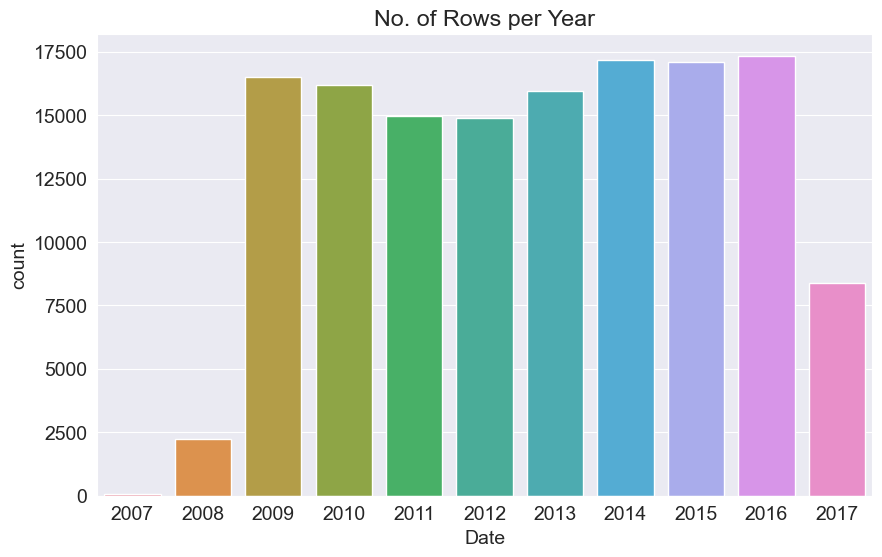

In [72]:
plt.title('No. of Rows per Year')
sns.countplot(x=pd.to_datetime(raw_df.Date).dt.year);

In [73]:

year = raw_df['Date'].dt.year
train_df = raw_df[year < 2015] # we will train the model on the data before 2015
val_df = raw_df[year == 2015]  # validation set would consist of data of 2015
test_df = raw_df[year > 2015]  # test set would consist of data after 2015
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)
     

train_df.shape : (97988, 135)
val_df.shape : (17089, 135)
test_df.shape : (25710, 135)


We have also ensured that the train validation and test sets all contain data for all 12 months of the year.

## Identifying the Input and Target Columns.

In [74]:
input_cols = numeric_cols + encoded_cols
target_col = 'RainTomorrow'

In [75]:
print(input_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Temp_diff', 'Pressure_diff', 'Humidity_diff', 'Location_Adelaide', 'Location_Albany', 'Location_Albury', 'Location_AliceSprings', 'Location_BadgerysCreek', 'Location_Ballarat', 'Location_Bendigo', 'Location_Brisbane', 'Location_Cairns', 'Location_Canberra', 'Location_Cobar', 'Location_CoffsHarbour', 'Location_Dartmoor', 'Location_Darwin', 'Location_GoldCoast', 'Location_Hobart', 'Location_Katherine', 'Location_Launceston', 'Location_Melbourne', 'Location_MelbourneAirport', 'Location_Mildura', 'Location_Moree', 'Location_MountGambier', 'Location_MountGinini', 'Location_Newcastle', 'Location_Nhil', 'Location_NorahHead', 'Location_NorfolkIsland', 'Location_Nuriootpa', 'Location_PearceRAAF', 'Location_Penrith', 'Location_Perth', 'Location_PerthAirport', 'Location_Portland', '

In [76]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_col].copy()

test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [77]:
# here we have only 23 percent of the data points for which it is raining tomorrow, this displays a class imbalance in 
# in the training data.
train_targets.value_counts()

RainTomorrow
No     76190
Yes    21798
Name: count, dtype: int64

## Scaling Numeric Features

This is required because:

1. Different features may have different scales, which can lead to numerical instability in many algorithms, Scaling ensures all the features are on the similar scale and no feature dominates the learning process just due to it's larger values.
2. Scaling further speeds up the Convergence of optimization algorithms, allowing them to reach the optimal solution more quickly and efficiently.
3. It enhances the performance of alogorithms that depend on distance based calculations or gradients.
4. Some algorithms, like linear regression, assess feature importance based on the magnitude of their coefficients. Scaling ensures that features with smaller numerical values are not overlooked when calculating importance.
5. Regularization techniques, like L1 and L2 regularization, are applied to penalize large coefficients in linear models. Scaling ensures that all features are penalized equally, regardless of their original scales.
6. Algorithms that rely on distance measures, such as clustering algorithms, are sensitive to feature scales. Scaling ensures that the distances are calculated correctly based on the actual significance of the features.
7. It's important to note that some algorithms, like tree-based models (Random Forest, Gradient Boosting), are less sensitive to feature scales due to their internal structures. However, in many cases, scaling still provides benefits and good practices for consistent performance across different types of algorithms.


In [78]:
raw_df[numeric_cols].describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Temp_diff,Pressure_diff,Humidity_diff
count,140787.000000,140787.000000,140787.000000,140787.000000,140787.00000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000
mean,12.184824,23.235120,2.349974,5.472516,7.63054,39.970520,13.990496,18.631141,68.826833,51.449288,1017.654577,1015.257963,4.431161,4.499250,16.987066,21.693183,11.051166,2.682175,19.658514
std,6.393226,7.106739,8.465173,3.179313,2.74139,13.131794,8.852853,8.718653,18.960664,20.546968,6.749189,6.682526,2.284253,2.109458,6.480860,6.872826,4.961959,1.468902,13.499574
min,-8.500000,-4.800000,0.000000,0.000000,0.00000,6.000000,0.000000,0.000000,0.000000,0.000000,980.500000,977.100000,0.000000,0.000000,-7.200000,-5.400000,0.000000,0.000000,0.000000
25%,7.600000,17.900000,0.000000,4.000000,7.63054,31.000000,7.000000,13.000000,57.000000,37.000000,1013.500000,1011.000000,3.000000,4.000000,12.300000,16.700000,7.200000,1.700000,9.000000
50%,12.000000,22.700000,0.000000,5.472516,7.63054,39.000000,13.000000,18.631141,70.000000,51.449288,1017.654577,1015.257963,4.431161,4.499250,16.800000,21.300000,10.500000,2.500000,18.000000
75%,16.800000,28.200000,0.800000,5.472516,8.70000,46.000000,19.000000,24.000000,83.000000,65.000000,1021.800000,1019.400000,6.000000,6.000000,21.500000,26.300000,14.500000,3.600000,29.000000
max,33.900000,48.100000,371.000000,145.000000,14.50000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,9.000000,40.200000,46.700000,31.215176,26.554577,91.000000


In [79]:
scaler = MinMaxScaler()
scaler.fit(raw_df[numeric_cols])
print(list(scaler.data_min_), list(scaler.data_max_))

[-8.5, -4.8, 0.0, 0.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 980.5, 977.1, 0.0, 0.0, -7.2, -5.4, 0.0, 0.0, 0.0] [33.9, 48.1, 371.0, 145.0, 14.5, 135.0, 130.0, 87.0, 100.0, 100.0, 1041.0, 1039.6, 9.0, 9.0, 40.2, 46.7, 31.21517613437952, 26.554577154371714, 91.0]


In [80]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [81]:
train_inputs[numeric_cols].info()

<class 'pandas.core.frame.DataFrame'>
Index: 97988 entries, 0 to 144552
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MinTemp        97988 non-null  float64
 1   MaxTemp        97988 non-null  float64
 2   Rainfall       97988 non-null  float64
 3   Evaporation    97988 non-null  float64
 4   Sunshine       97988 non-null  float64
 5   WindGustSpeed  97988 non-null  float64
 6   WindSpeed9am   97988 non-null  float64
 7   WindSpeed3pm   97988 non-null  float64
 8   Humidity9am    97988 non-null  float64
 9   Humidity3pm    97988 non-null  float64
 10  Pressure9am    97988 non-null  float64
 11  Pressure3pm    97988 non-null  float64
 12  Cloud9am       97988 non-null  float64
 13  Cloud3pm       97988 non-null  float64
 14  Temp9am        97988 non-null  float64
 15  Temp3pm        97988 non-null  float64
 16  Temp_diff      97988 non-null  float64
 17  Pressure_diff  97988 non-null  float64
 18  Humidity_d

In [82]:
train_targets.info()

<class 'pandas.core.series.Series'>
Index: 97988 entries, 0 to 144552
Series name: RainTomorrow
Non-Null Count  Dtype 
--------------  ----- 
97988 non-null  object
dtypes: object(1)
memory usage: 1.5+ MB


## Training a Logistic Model

In [83]:
print(len(numeric_cols + encoded_cols))

125


In [84]:
train_inputs.info()

<class 'pandas.core.frame.DataFrame'>
Index: 97988 entries, 0 to 144552
Columns: 125 entries, MinTemp to Combined_Feature_Medium_Medium
dtypes: float64(125)
memory usage: 94.2 MB


Before we had 97988 rows but after resampling we had now 152380 rows

In [85]:
model = LogisticRegression(solver='liblinear')
model.fit(train_inputs, train_targets)

LogisticRegression(solver='liblinear')

In [86]:
print(model.coef_.tolist(), model.intercept_)

[[-0.7747766564966065, -1.5311655835693094, 3.6462069741049876, 1.0884863806751048, -1.4407296011955006, 6.464093253542256, -0.6571292476960638, -1.4834485681610943, -0.3178328415620363, 6.655064571268934, 3.3822794607701976, -6.863817436379, -0.2113619960093253, 1.2473578793802822, 0.8302115203791482, 2.733380987294662, -1.5153531626638777, 2.988684449463487, 0.875752313723212, 0.6193018874175223, -0.2863226664219107, 0.3647179105960317, 0.03769980125187778, 0.22025637227722342, -0.35978268309751515, 0.11931263828794207, 0.4573235210492362, -0.05800495167794752, 0.06377748379565912, 0.21252889979692657, 0.03108089360992029, -0.005080409084629681, -0.5019460441669291, -0.28542110209316196, -0.5508662490754386, -1.0625146483145358, -0.3335518548552272, -0.2269640707716608, -0.44417833455156247, 0.12447708498401444, 0.06660142882579949, 0.14378931748446633, -0.9563932826648947, -0.3388531952245991, -0.05923015392931926, -0.5440333473562486, -0.42689433579024644, -0.01859007335099907, 0.3

## Making Prediction and Evaluating The Model

In [87]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [88]:
train_preds = model.predict(X_train)

In [89]:
train_preds, train_targets

(array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object),
 0         No
 1         No
 2         No
 3         No
 4         No
           ..
 144548    No
 144549    No
 144550    No
 144551    No
 144552    No
 Name: RainTomorrow, Length: 97988, dtype: object)

In [90]:
# We can output a probabilistic prediction using predict_proba.
train_probs = model.predict_proba(X_train)
train_probs

array([[0.94664567, 0.05335433],
       [0.94770026, 0.05229974],
       [0.96633695, 0.03366305],
       ...,
       [0.98736758, 0.01263242],
       [0.98143109, 0.01856891],
       [0.85951242, 0.14048758]])

We can test the accuracy of the model's predictions by computing the percentage of matching values in train_preds and train_targets.

In [91]:
accuracy_score(train_targets, train_preds)

0.8525431685512511

Hence the Logistics Regression Model gives an accuracy of 85.25% on the training set

In [92]:
val_preds = model.predict(X_val)

In [93]:
val_preds, val_targets

(array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object),
 2133      No
 2134      No
 2135      No
 2136      No
 2137      No
           ..
 144913    No
 144914    No
 144915    No
 144916    No
 144917    No
 Name: RainTomorrow, Length: 17089, dtype: object)

In [94]:
accuracy_score(val_preds, val_targets)

0.8548774065188133

The logistics Regression model gives an accuracy of 85.48% on the validation set.

In [95]:
test_preds = model.predict(X_test)
accuracy_score(test_targets, test_preds)

0.8422792687670168

The Logistics Regression model gives an accuracy of 84.22% on the Test set.

In [96]:
from sklearn.metrics import confusion_matrix

In [97]:
confusion_matrix(train_targets, train_preds, normalize='true')

array([[0.94576716, 0.05423284],
       [0.4733003 , 0.5266997 ]])

In [98]:
# defining a helper function to generate predictions, compute the accuracy score, and plot a confusion matrix for a given 
# set of inputs.

def predict_and_plot(inputs, targets, name=''):
    preds = model.predict(inputs)
    
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));
    
    return preds

Accuracy: 85.25%


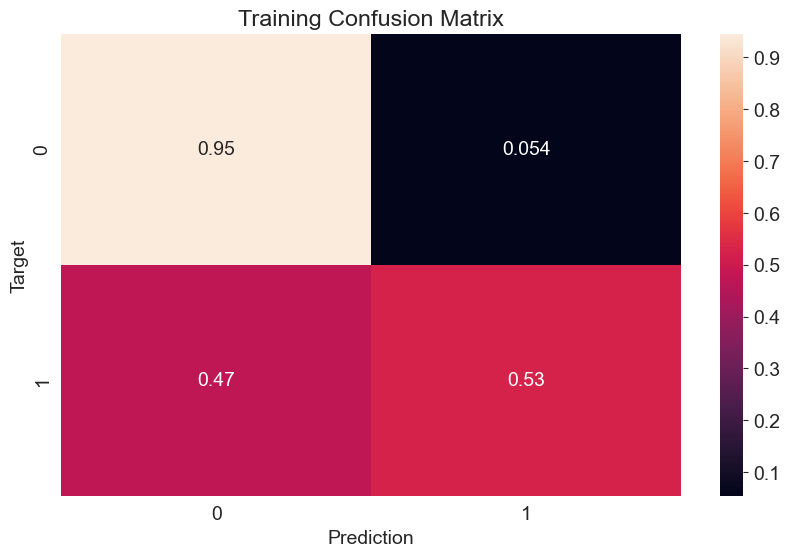

In [99]:
train_preds = predict_and_plot(X_train, train_targets, 'Training')

Accuracy: 85.49%


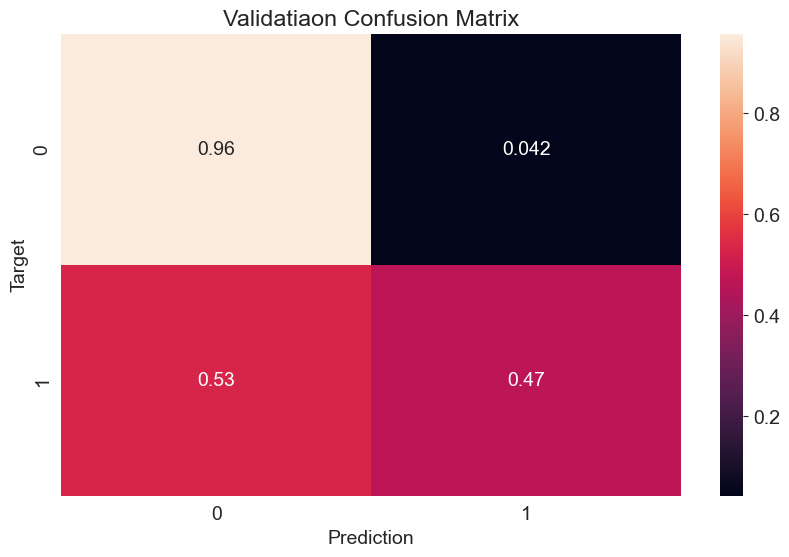

In [100]:
val_preds = predict_and_plot(X_val, val_targets, 'Validatiaon')

Accuracy: 84.23%


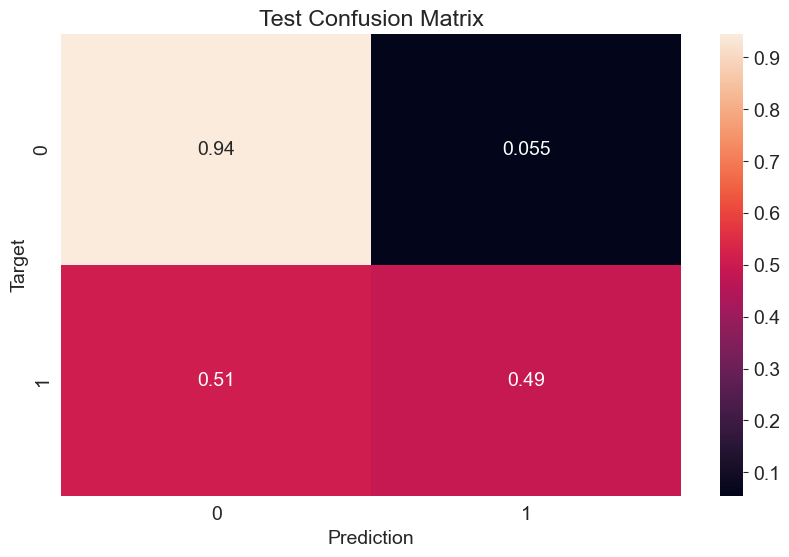

In [101]:
test_preds = predict_and_plot(X_test, test_targets, 'Test')

In [102]:
# Let's check how good is the accuracy of 84%

In [103]:
def random_guess(inputs):
    return np.random.choice(["No", "Yes"], len(inputs))

In [104]:
accuracy_score(test_targets, random_guess(X_test))

0.4980163360560093

In [105]:
def all_no(inputs):
    return np.full(len(inputs), "No")
accuracy_score(test_targets, all_no(X_test))

0.7734344612991054

Our random model achieves an accuracy of 50% and our "always No" model achieves an accuracy of 77%. 

Thus, our model is better than a "dumb" or "random" model!

### Making prediction on a new input

In [106]:
new_input = {'Date': '2021-06-19',
             'Location': 'Katherine',
             'MinTemp': 23.2,
             'MaxTemp': 33.2,
             'Rainfall': 10.2,
             'Evaporation': 4.2,
             'Sunshine': np.nan,
             'WindGustDir': 'NNW',
             'WindGustSpeed': 52.0,
             'WindDir9am': 'NW',
             'WindDir3pm': 'NNE',
             'WindSpeed9am': 13.0,
             'WindSpeed3pm': 20.0,
             'Humidity9am': 89.0,
             'Humidity3pm': 58.0,
             'Pressure9am': 1004.8,
             'Pressure3pm': 1001.5,
             'Cloud9am': 8.0,
             'Cloud3pm': 5.0,
             'Temp9am': 25.7,
             'Temp3pm': 33.0,
             'RainToday': 'Yes'}

In [107]:
new_input_df = pd.DataFrame([new_input])

In [108]:
numeric_cols = new_input_df.select_dtypes(include=np.number).columns.tolist()
categorical_cols = new_input_df.select_dtypes('object').columns.tolist()

In [109]:
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'] ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']


In [110]:
categorical_cols.remove("Date")

In [111]:
new_input_df[numeric_cols] = imputer1.transform(new_input_df[numeric_cols])
new_input_df[categorical_cols] = imputer2.transform(new_input_df[categorical_cols])

In [112]:
new_input_df['Temp_diff'] = abs(new_input_df['Temp3pm']-new_input_df['Temp9am'])
new_input_df['Pressure_diff'] = abs(new_input_df['Pressure3pm']-new_input_df['Pressure9am'])
new_input_df['Humidity_diff'] = abs(new_input_df['Humidity3pm']-new_input_df['Humidity9am'])

In [113]:
new_input_df['Sunshine_Category'] = pd.cut(new_input_df['Sunshine'], bins=sunshine_bins, labels=['Low', 'Medium', 'High'])
new_input_df['Rainfall_Category'] = pd.cut(new_input_df['Rainfall'], bins=rainfall_bins, labels=['Low', 'Medium', 'High'])
new_input_df['Combined_Feature'] = new_input_df['Sunshine_Category'].astype(str) + '_' + new_input_df['Rainfall_Category'].astype(str)

In [114]:
numeric_cols = new_input_df.select_dtypes(include=np.number).columns.tolist()
categorical_cols = new_input_df.select_dtypes('object').columns.tolist()

In [115]:
print(numeric_cols, categorical_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Temp_diff', 'Pressure_diff', 'Humidity_diff'] ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'Combined_Feature']


In [116]:
categorical_cols.remove('Date')

In [117]:
new_input_df[numeric_cols] = scaler.transform(new_input_df[numeric_cols])
new_input_df[encoded_cols] = encoder.transform(new_input_df[categorical_cols])

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2563238450.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2563238450.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\User\AppData\Local\Temp\ipykernel_14696\2563238450.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented fra

In [118]:
X_new_input = new_input_df[numeric_cols + encoded_cols]
X_new_input

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_WSW,RainToday_No,RainToday_Yes,Combined_Feature_High_Low,Combined_Feature_High_Medium,Combined_Feature_Low_High,Combined_Feature_Low_Low,Combined_Feature_Low_Medium,Combined_Feature_Medium_Low,Combined_Feature_Medium_Medium
0,0.747642,0.718336,0.027493,0.028966,0.526244,0.356589,0.1,0.229885,0.89,0.58,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [119]:
prediction = model.predict(X_new_input)[0]

In [120]:
prediction

'Yes'

In [121]:
# def predict_input(single_input):
#     input_df = pd.DataFrame([single_input])
#     input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
#     input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
#     input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
#     X_input = input_df[numeric_cols + encoded_cols]
#     pred = model.predict(X_input)[0]
#     prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
#     return pred, prob

## Decision Trees

In [122]:
import opendatasets as od
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib
import jovian
import os
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 150)
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [123]:
from sklearn.tree import DecisionTreeClassifier

In [124]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [125]:
X_train

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Temp_diff,Pressure_diff,Humidity_diff,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_BadgerysCreek,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,Location_MountGinini,Location_Newcastle,Location_Nhil,Location_NorahHead,Location_NorfolkIsland,Location_Nuriootpa,Location_PearceRAAF,Location_Penrith,Location_Perth,Location_PerthAirport,Location_Portland,Location_Richmond,Location_Sale,Location_SalmonGums,Location_Sydney,Location_SydneyAirport,Location_Townsville,Location_Tuggeranong,Location_Uluru,Location_WaggaWagga,Location_Walpole,Location_Watsonia,Location_Williamtown,Location_Witchcliffe,Location_Wollongong,Location_Woomera,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_E,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes,Combined_Feature_High_Low,Combined_Feature_High_Medium,Combined_Feature_Low_High,Combined_Feature_Low_Low,Combined_Feature_Low_Medium,Combined_Feature_Medium_Low,Combined_Feature_Medium_Medium
0,0.516509,0.523629,0.001617,0.037741,0.526244,0.294574,0.153846,0.275862,0.71,0.22,0.449587,0.4800,0.888889,0.499917,0.508439,0.522073,0.304339,0.022595,0.538462,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.375000,0.565217,0.000000,0.037741,0.526244,0.294574,0.030769,0.252874,0.44,0.25,0.497521,0.4912,0.492351,0.499917,0.514768,0.570058,0.567032,0.105443,0.208791,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.504717,0.576560,0.000000,0.037741,0.526244,0.310078,0.146154,0.298851,0.38,0.30,0.447934,0.5056,0.492351,0.222222,0.594937,0.548944,0.410057,0.041424,0.087912,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.417453,0.620038,0.000000,0.037741,0.526244,0.139535,0.084615,0.103448,0.45,0.16,0.613223,0.5712,0.492351,0.499917,0.533755,0.612284,0.602271,0.180760,0.318681,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0

In [126]:
train_targets

0         No
1         No
2         No
3         No
4         No
          ..
144548    No
144549    No
144550    No
144551    No
144552    No
Name: RainTomorrow, Length: 97988, dtype: object

In [127]:
model = DecisionTreeClassifier(random_state=42)

In [128]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 6.03 s
Wall time: 6.37 s


DecisionTreeClassifier(random_state=42)

In [129]:
from sklearn.metrics import accuracy_score, confusion_matrix

In [130]:
train_preds = model.predict(X_train)

In [131]:
print(train_preds)

['No' 'No' 'No' ... 'No' 'No' 'No']


In [132]:
pd.value_counts(train_preds)

No     76192
Yes    21796
Name: count, dtype: int64

In [133]:
accuracy_score(train_targets, train_preds)

0.9999795893374699

The training set accuracy is 100%, but we are not interested in this, the area of interest is to see how well does the model generalizes to unseen data.

In [134]:
val_preds = model.predict(X_val)
accuracy_score(val_targets, val_preds)

0.7956580256305226

In [135]:
test_preds = model.predict(X_test)
accuracy_score(test_targets, test_preds)

0.7768572539867755

It seems that apart from achieving 100% accuracy on the training set, the validation and the test accuracy is pretty low, this indicates that the model has memorized the training examples and do not generalize well to the unseen data. This is overfitting or we can say that the model has has variance.

#### Creating some visualizations

In [136]:
from sklearn.tree import plot_tree, export_text

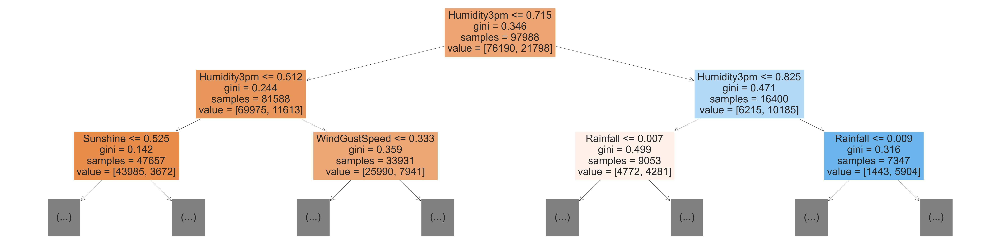

In [137]:
plt.figure(figsize=(80,20))
plot_tree(model, feature_names=X_train.columns, max_depth=2, filled=True);

In [138]:
model.tree_.max_depth

44

##### Feature Importance

Based on the gini index computations, a decision tree assigns an "importance" value to each feature. These values can be used to interpret the results given by a decision tree.

In [139]:
model.feature_importances_

array([3.09888991e-02, 2.59074034e-02, 4.26778797e-02, 1.96168825e-02,
       4.21874355e-02, 5.72379152e-02, 2.24497365e-02, 2.51520989e-02,
       2.78929006e-02, 2.72526734e-01, 2.89496992e-02, 5.64992057e-02,
       1.07261972e-02, 1.58371547e-02, 3.01378363e-02, 2.73333759e-02,
       3.39231403e-02, 3.23906915e-02, 2.72769820e-02, 2.50914949e-03,
       1.00483407e-03, 1.60718010e-03, 4.94220030e-04, 1.40542301e-03,
       8.64938594e-04, 1.14721196e-03, 1.40280624e-03, 7.33858735e-04,
       1.42218333e-03, 6.86294546e-04, 2.15946036e-03, 1.66364860e-03,
       3.89272731e-04, 7.03592058e-04, 1.73367340e-03, 3.00474759e-04,
       8.80492445e-04, 6.71195794e-04, 8.88205447e-04, 8.21457535e-04,
       8.94253508e-04, 1.90433344e-03, 1.21602137e-03, 3.00206581e-04,
       7.56533068e-04, 1.06065185e-03, 2.02037890e-03, 1.21120820e-03,
       1.05100379e-03, 8.82884068e-04, 1.33813072e-03, 1.69769962e-03,
       1.56419953e-03, 6.14607136e-04, 1.70958708e-03, 1.26624124e-03,
      

In [140]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [141]:
importance_df.head(10)

,feature,importance
9,Humidity3pm,0.272527
5,WindGustSpeed,0.057238
11,Pressure3pm,0.056499
2,Rainfall,0.042678
4,Sunshine,0.042187
16,Temp_diff,0.033923
17,Pressure_diff,0.032391
0,MinTemp,0.030989
14,Temp9am,0.030138
10,Pressure9am,0.028950


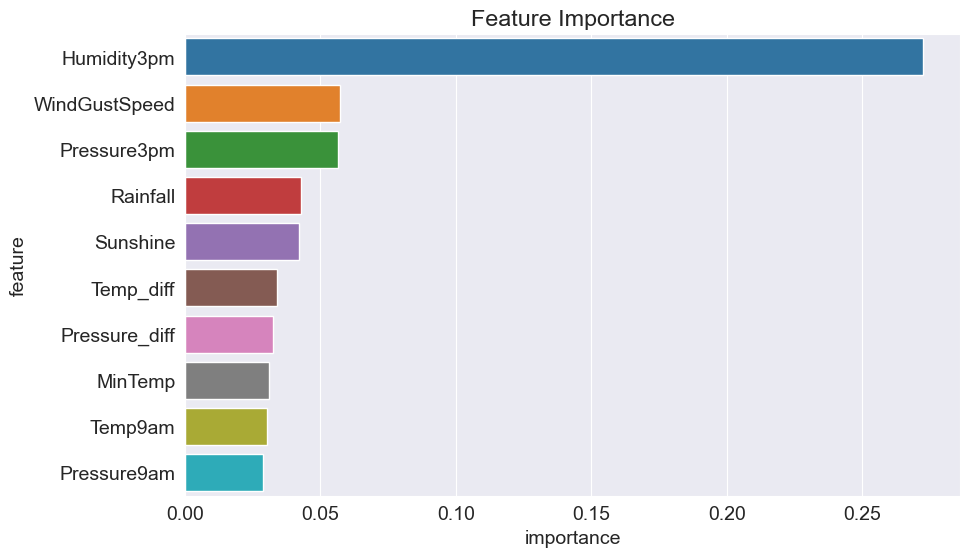

In [142]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

##### Hyperparameter Tuning and Reducing Overfitting

In [143]:
model = DecisionTreeClassifier(max_depth=3, random_state=42)

In [144]:
model.fit(X_train, train_targets)

DecisionTreeClassifier(max_depth=3, random_state=42)

In [145]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.8315916234640977, 0.8348060155655685)

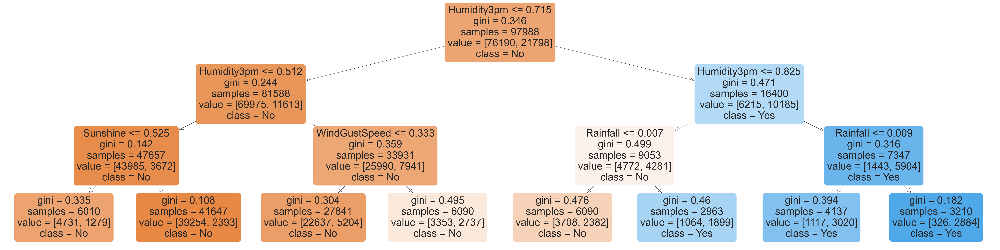

In [146]:
plt.figure(figsize=(80,20))
plot_tree(model, feature_names=X_train.columns, filled=True, rounded=True, class_names=model.classes_);

In [147]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth=md, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    val_acc = 1 - model.score(X_val, val_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Validation Error': val_acc}

In [148]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: total: 1min 7s
Wall time: 1min 11s


In [149]:
errors_df.sort_values('Validation Error', ascending = True)

,Max Depth,Training Error,Validation Error
7,8,0.144232,0.152554
9,10,0.131190,0.154661
6,7,0.149437,0.155656
8,9,0.139486,0.155773
5,6,0.153162,0.156007
10,11,0.121821,0.156241
4,5,0.157244,0.158113
11,12,0.111299,0.159459
3,4,0.162153,0.161624
12,13,0.099175,0.162619


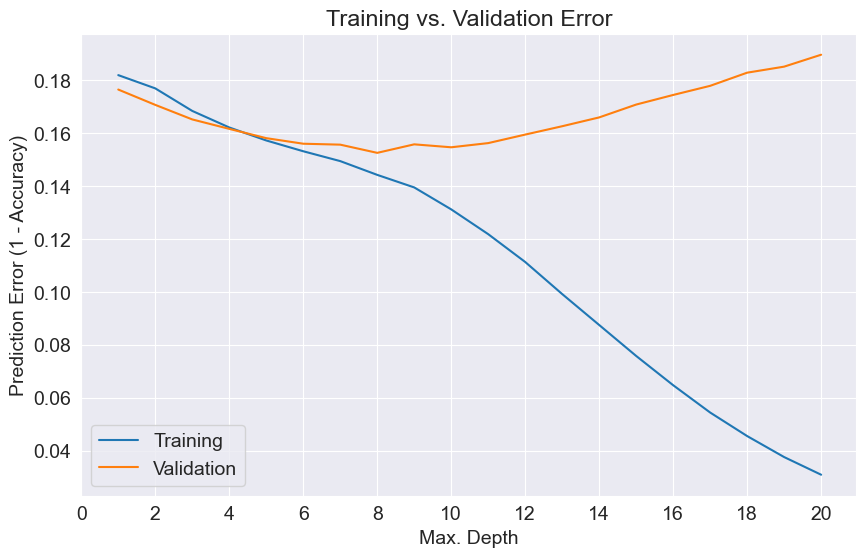

In [150]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Validation Error'])
plt.title('Training vs. Validation Error')
plt.xticks(range(0,21, 2))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

Thus from the diagram it is that the max_depth of 8 gives a balanced train_accuracy as well as validation set accuracy.

In [151]:
model = DecisionTreeClassifier(max_depth=8, random_state=42).fit(X_train, train_targets)
model.score(X_val, val_targets)

0.8474457253203815

#### Max_leaf_nodes

In [152]:
model = DecisionTreeClassifier(max_leaf_nodes=128, random_state=42)

In [153]:
model.fit(X_train, train_targets)

DecisionTreeClassifier(max_leaf_nodes=128, random_state=42)

In [154]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.8527983018328775, 0.8467435192228919)

In [155]:
model.tree_.max_depth

11

In [156]:
# finding a combination of max_depth and max_leaf_nodes that gives least validation set error.

In [157]:
def depth_leaf(depth_list, max_leaf_list):
    combination = []
    train_acc_list = []
    val_acc_list = []
    
    for i in depth_list:
        for j in max_leaf_list:
            combination.append([i, j])
            model = DecisionTreeClassifier(max_depth=i, max_leaf_nodes=j, random_state=42)
            model.fit(X_train, train_targets)
            train_acc = model.score(X_train, train_targets)
            val_acc = model.score(X_val, val_targets)
            train_acc_list.append(train_acc)
            val_acc_list.append(val_acc)
            
    data = {'Combination': combination, 'Training_accuracy': train_acc_list, 'Validation_accuracy': val_acc_list}
    df = pd.DataFrame(data)
    
    return df

In [158]:
comb = depth_leaf([i for i in range(5,11)], [i for i in range(100,130)])

In [159]:
comb.sort_values('Validation_accuracy', ascending = False)

,Combination,Training_accuracy,Validation_accuracy
140,"[9, 120]",0.851778,0.847036
116,"[8, 126]",0.852768,0.846919
114,"[8, 124]",0.852768,0.846919
115,"[8, 125]",0.852768,0.846919
119,"[8, 129]",0.852860,0.846861
...,...,...,...
18,"[5, 118]",0.842756,0.841887
17,"[5, 117]",0.842756,0.841887
16,"[5, 116]",0.842756,0.841887
15,"[5, 115]",0.842756,0.841887


Thus the decision tree with max_depth of 9 and maximum leaf nodes of 120 gives the highest validation accuracy of 84.7%

### Training a random Forest

The random forest model is a model in which we combine the results of several decision trees trained with slightly different parameters. The idea is that each decision tree in the forest would make some kind of errors and upon averaging, many of these errors will cancel out.

In [160]:
from sklearn.ensemble import RandomForestClassifier

In [161]:
model = RandomForestClassifier(n_jobs=-1, random_state=42)

`n_jobs` allows the random forest to use mutiple parallel workers to train decision trees, and `random_state=42` ensures that the we get the same results for each execution.

In [162]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 1min 11s
Wall time: 18.4 s


RandomForestClassifier(n_jobs=-1, random_state=42)

In [163]:

model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9999693840062048, 0.8595002633272866)

In [164]:
train_probs = model.predict_proba(X_train)
train_probs

array([[0.97, 0.03],
       [0.98, 0.02],
       [0.98, 0.02],
       ...,
       [1.  , 0.  ],
       [1.  , 0.  ],
       [0.97, 0.03]])

Looking at individual decision trees

In [165]:
model.estimators_[0]

DecisionTreeClassifier(max_features='sqrt', random_state=1608637542)

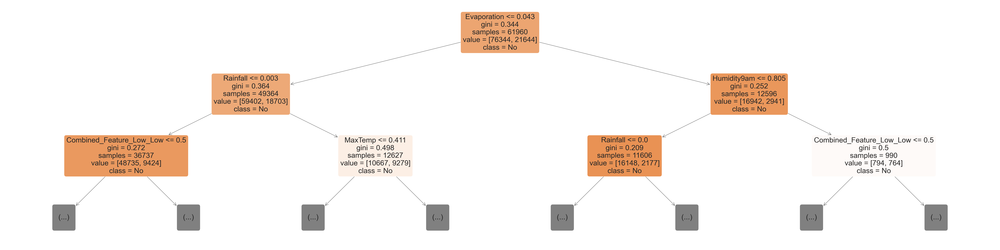

In [166]:
plt.figure(figsize=(80,20))
plot_tree(model.estimators_[0], max_depth=2, feature_names=X_train.columns, filled=True, rounded=True, class_names=model.classes_);

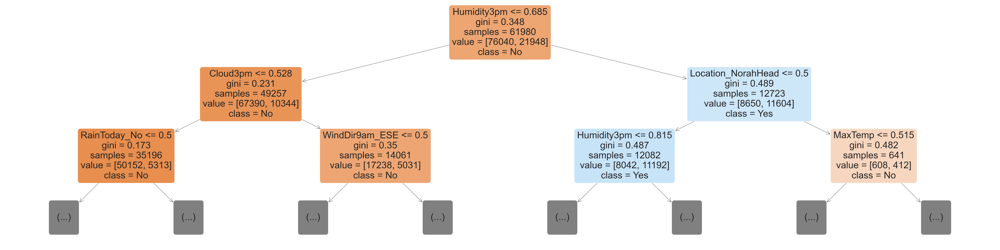

In [167]:
plt.figure(figsize=(80,20))
plot_tree(model.estimators_[20], max_depth=2, feature_names=X_train.columns, filled=True, rounded=True, class_names=model.classes_);

In [168]:
len(model.estimators_)

100

In [169]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [170]:
importance_df.head(10)

,feature,importance
9,Humidity3pm,0.124508
16,Temp_diff,0.054073
11,Pressure3pm,0.046487
8,Humidity9am,0.044021
5,WindGustSpeed,0.043588
10,Pressure9am,0.041431
4,Sunshine,0.040077
18,Humidity_diff,0.037087
2,Rainfall,0.036341
15,Temp3pm,0.036119


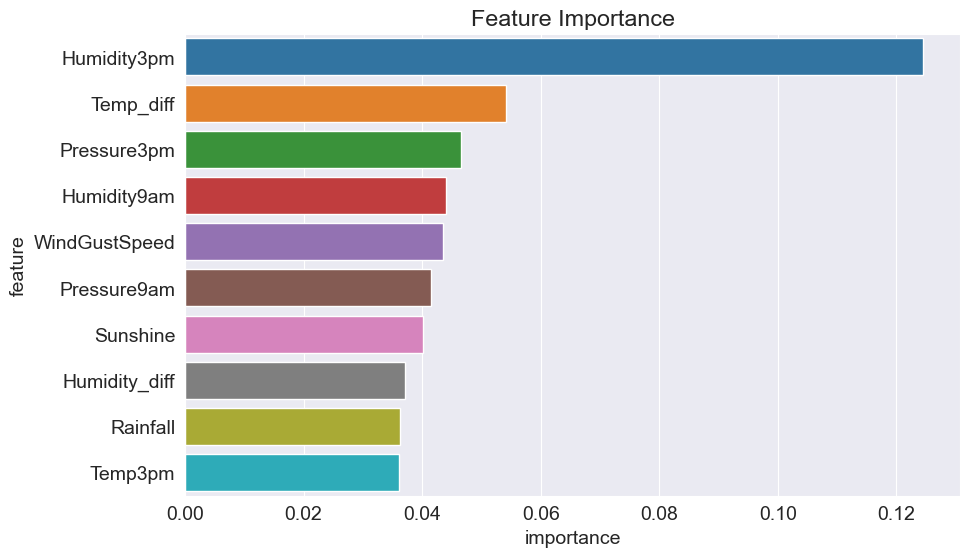

In [171]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

An important insight about the usefullness of ensembling technique is that the distribution of important features is much less skewed now than it was before when we were fitting a single decision tree.

### Hyperparameter tunning with Random Forest

In [172]:
base_model = RandomForestClassifier(random_state=42, n_jobs=-1).fit(X_train, train_targets)

In [173]:
base_train_acc = base_model.score(X_train, train_targets)
base_val_acc = base_model.score(X_val, val_targets)

In [174]:
base_accs = base_train_acc, base_val_acc
base_accs

(0.9999693840062048, 0.8595002633272866)

### Some more hyperparameters

#### n_estimators : 
This controls the number of decision trees in the random forest

In [175]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=10)

In [176]:
%%time
model.fit(X_train, train_targets)
model.score(X_train, train_targets), model.score(X_val, val_targets)

CPU times: total: 7.89 s
Wall time: 2.85 s


(0.987253541249949, 0.8442272807068875)

In [177]:
base_accs

(0.9999693840062048, 0.8595002633272866)

In [178]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=500)
model.fit(X_train, train_targets)

RandomForestClassifier(n_estimators=500, n_jobs=-1, random_state=42)

In [179]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9999795893374699, 0.8583884370062613)

In [180]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=250)
model.fit(X_train, train_targets)
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9999795893374699, 0.8589150915793785)

#### Max Leaf Nodes and Max Depth

In [181]:
# making a helper function to test hyperparameters
def test_params(**params):
    model = RandomForestClassifier(random_state=42, n_jobs=-1, **params).fit(X_train, train_targets)
    return model.score(X_train, train_targets), model.score(X_val, val_targets)

In [182]:
test_params(max_depth=26)

(0.9890598848838633, 0.8588565744045877)

In [183]:
test_params(max_leaf_nodes=2**20)

(0.9999795893374699, 0.8577447480835625)

In [184]:
base_accs

(0.9999693840062048, 0.8595002633272866)

Let's put the value of previously obtained max_leaf_nodes and max_max_depth

In [185]:
test_params(max_leaf_nodes = 250, max_depth = 9)

(0.8526452218639017, 0.8463924161741471)

The accuracy seems to be low

In [186]:
#  max_features: default value is sqrt(n), that means:
#  only sqrt(n) out of total features (n) to be chosen randomly at each split

In [187]:
test_params(max_features='log2')

(0.9999693840062048, 0.8551114752179765)

### `min_samples_split` and `min_samples_leaf`

By default, the decision tree classifier tries to split every node that has 2 or more. You can increase the values of these arguments to change this behavior and reduce overfitting, especially for very large datasets.

In [188]:
test_params(min_samples_split=100, min_samples_leaf=60)

(0.8533187737273952, 0.8486160688161976)

In [189]:
test_params(min_samples_split=50, min_samples_leaf=10)

(0.8747601747152712, 0.8542922347709052)

### `min_impurity_decrease`

This argument is used to control the threshold for splitting nodes. A node will be split if this split induces a decrease of the impurity (Gini index) greater than or equal to this value. It's default value is 0, and you can increase it to reduce overfitting.


In [190]:
test_params(min_impurity_decrease=1e-7)

(0.9997856880434339, 0.8581543683070981)

In [191]:
base_accs

(0.9999693840062048, 0.8595002633272866)

#### `bootstrap`, `max_samples` 

By default, a random forest doesn't use the entire dataset for training each decision tree. Instead it applies a technique called bootstrapping. For each tree, rows from the dataset are picked one by one randomly, with replacement i.e. some rows may not show up at all, while some rows may show up multiple times.


<img src="https://i.imgur.com/W8UGaEA.png" width="640">

Bootstrapping helps the random forest generalize better, because each decision tree only sees a fraction of th training set, and some rows randomly get higher weightage than others.

In [192]:
test_params(bootstrap=False)

(0.9999795893374699, 0.858505471355843)

In [193]:
base_accs

(0.9999693840062048, 0.8595002633272866)

In [194]:
test_params(max_samples=0.9)

(0.9998469200310242, 0.8578032652583534)

#### class_weights

The purpose of using class weights is to address class imbalance in the training data. When one class has significantly more samples than the other, it might lead the model to be biased towards the majority class. Assigning higher weights to the minority class helps the model pay more attention to it and prevents it from being overshadowed by the majority class

In [195]:
test_params(class_weight={'No': 1, 'Yes': 4})

(0.9999693840062048, 0.8564573702381649)

In [196]:
# so finally we have:

model = RandomForestClassifier(n_jobs=-1, 
                               random_state=42, 
                               n_estimators=500,
                               max_features=7,
                               max_depth=30, 
                               class_weight={'No': 1, 'Yes': 1.5})

In [197]:
model.fit(X_train, train_targets)

RandomForestClassifier(class_weight={'No': 1, 'Yes': 1.5}, max_depth=30,
                       max_features=7, n_estimators=500, n_jobs=-1,
                       random_state=42)

In [198]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9948463077111483, 0.8585639885306338)

In [199]:
base_accs

(0.9999693840062048, 0.8595002633272866)

## SVM classifier

In [203]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Initialize and train an SVM classifier
svm_classifier = SVC(kernel="linear")  # You can experiment with different kernels
svm_classifier.fit(X_train, train_targets)

# Make predictions on the test set
predictions = svm_classifier.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(test_targets, predictions)
print("Accuracy:", accuracy)

classification_rep = classification_report(test_targets, predictions)
print("Classification Report:\n", classification_rep)


Accuracy: 0.8427460132244263
Classification Report:
               precision    recall  f1-score   support

          No       0.86      0.95      0.90     19885
         Yes       0.75      0.46      0.57      5825

    accuracy                           0.84     25710
   macro avg       0.80      0.71      0.74     25710
weighted avg       0.83      0.84      0.83     25710



In [205]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Initialize and train an SVM classifier
svm_classifier = SVC(kernel="rbf")  # You can experiment with different kernels
svm_classifier.fit(X_train, train_targets)

# Make predictions on the test set
predictions = svm_classifier.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(test_targets, predictions)
print("Accuracy:", accuracy)

classification_rep = classification_report(test_targets, predictions)
print("Classification Report:\n", classification_rep)


Accuracy: 0.8500583430571762
Classification Report:
               precision    recall  f1-score   support

          No       0.86      0.96      0.91     19885
         Yes       0.78      0.47      0.59      5825

    accuracy                           0.85     25710
   macro avg       0.82      0.71      0.75     25710
weighted avg       0.84      0.85      0.84     25710



In [206]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Initialize and train an SVM classifier
svm_classifier = SVC(kernel="poly")  # You can experiment with different kernels
svm_classifier.fit(X_train, train_targets)

# Make predictions on the test set
predictions = svm_classifier.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(test_targets, predictions)
print("Accuracy:", accuracy)

classification_rep = classification_report(test_targets, predictions)
print("Classification Report:\n", classification_rep)


Accuracy: 0.8529366005445352
Classification Report:
               precision    recall  f1-score   support

          No       0.86      0.96      0.91     19885
         Yes       0.78      0.48      0.60      5825

    accuracy                           0.85     25710
   macro avg       0.82      0.72      0.75     25710
weighted avg       0.85      0.85      0.84     25710



## Conclusion:

For all the models applied in the study, It was found that Random Forest gives the best validation set accuracy i.e. 85.95% Hence we finally select that model.

## Future work ideas:

Since this data is a Spatio-Temporal data i.e. it includes both Spatial and Time component, so Analyzing these kind of data often involves techniques like space-time clustering, geostatistics, spatial interpolation, times series analysis, and various machine learning and data mining techinques that are tailored for such spatio-temporal patterns. Further I believe this would also require some doamin specific knowledge of geography and rainfall related sciences.

Studying this data as a spatio-temporal data can provide insights into dynamic processes that occur across both space and time, enabling more accurate predictions, better decision-making, and a deeper understanding of complex phenomena.

Examples of other models that could be used are: Long Short-Term Memory (LSTM) Networks, Convolutional Neural Networks (CNNs), Kriging, Spatial Regression(Geographically Weighted Regression (GWR) and Spatial Autoregressive Models (SAR) fall under this category) etc.

## References:

Books:
1. ISLR
2. Internet